In [46]:
# ! pip install plotly

In [47]:
# import the libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import bar_chart_race as bcr

In [48]:
# Load the dataset

df = pd.read_csv("E:\Excel_files\Car_hackathon.csv")

In [49]:
# checking the head and tail

df.head()

,VIN (1-10),County,City,State,Postal Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location,Electric Utility,2020 Census Tract
0,JTMEB3FV6N,Monroe,Key West,FL,33040,2022,TOYOTA,RAV4 PRIME,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,42,0,NaN,198968248,POINT (-81.80023 24.5545),NaN,12087972100
1,1G1RD6E45D,Clark,Laughlin,NV,89029,2013,CHEVROLET,VOLT,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,38,0,NaN,5204412,POINT (-114.57245 35.16815),NaN,32003005702
2,JN1AZ0CP8B,Yakima,Yakima,WA,98901,2011,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,73,0,15.0,218972519,POINT (-120.50721 46.60448),PACIFICORP,53077001602
3,1G1FW6S08H,Skagit,Concrete,WA,98237,2017,CHEVROLET,BOLT EV,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,238,0,39.0,186750406,POINT (-121.7515 48.53892),PUGET SOUND ENERGY INC,53057951101
4,3FA6P0SU1K,Snohomish,Everett,WA,98201,2019,FORD,FUSION,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,26,0,38.0,2006714,POINT (-122.20596 47.97659),PUGET SOUND ENERGY INC,53061041500


In [50]:
df.tail()

,VIN (1-10),County,City,State,Postal Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location,Electric Utility,2020 Census Tract
112629,7SAYGDEF2N,King,Duvall,WA,98019,2022,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not b...,0,0,45.0,217955265,POINT (-121.98609 47.74068),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),53033032401
112630,1N4BZ1CP7K,San Juan,Friday Harbor,WA,98250,2019,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,150,0,40.0,103663227,POINT (-123.01648 48.53448),BONNEVILLE POWER ADMINISTRATION||ORCAS POWER &...,53055960301
112631,1FMCU0KZ4N,King,Vashon,WA,98070,2022,FORD,ESCAPE,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,38,0,34.0,193878387,POINT (-122.4573 47.44929),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),53033027702
112632,KNDCD3LD4J,King,Covington,WA,98042,2018,KIA,NIRO,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,26,0,47.0,125039043,POINT (-122.09124 47.33778),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),53033032007
112633,YV4BR0CL8N,King,Covington,WA,98042,2022,VOLVO,XC90,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,18,0,47.0,194673692,POINT (-122.09124 47.33778),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),53033032005


In [51]:
df.describe()

,Postal Code,Model Year,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,2020 Census Tract
count,112634.000000,112634.000000,112634.000000,112634.000000,112348.000000,1.126340e+05,1.126340e+05
mean,98156.226850,2019.003365,87.812987,1793.439681,29.805604,1.994567e+08,5.296650e+10
std,2648.733064,2.892364,102.334216,10783.753486,14.700545,9.398427e+07,1.699104e+09
min,1730.000000,1997.000000,0.000000,0.000000,1.000000,4.777000e+03,1.101001e+09
25%,98052.000000,2017.000000,0.000000,0.000000,18.000000,1.484142e+08,5.303301e+10
50%,98119.000000,2020.000000,32.000000,0.000000,34.000000,1.923896e+08,5.303303e+10
75%,98370.000000,2022.000000,208.000000,0.000000,43.000000,2.191899e+08,5.305307e+10
max,99701.000000,2023.000000,337.000000,845000.000000,49.000000,4.792548e+08,5.603300e+10


### Exploratory Data Analysis

In [52]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112634 entries, 0 to 112633
Data columns (total 17 columns):
 #   Column                                             Non-Null Count   Dtype  
---  ------                                             --------------   -----  
 0   VIN (1-10)                                         112634 non-null  object 
 1   County                                             112634 non-null  object 
 2   City                                               112634 non-null  object 
 3   State                                              112634 non-null  object 
 4   Postal Code                                        112634 non-null  int64  
 5   Model Year                                         112634 non-null  int64  
 6   Make                                               112634 non-null  object 
 7   Model                                              112614 non-null  object 
 8   Electric Vehicle Type                              112634 non-null  object

In [53]:
## Check for duplicates

df.duplicated().value_counts()

False    112634
Name: count, dtype: int64

### handling Missing values

In [54]:
## Identify the nan values

df.isna()

,VIN (1-10),County,City,State,Postal Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location,Electric Utility,2020 Census Tract
0,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False
1,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112629,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
112630,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
112631,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
112632,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [55]:
df.isna().sum()

VIN (1-10)                                             0
County                                                 0
City                                                   0
State                                                  0
Postal Code                                            0
Model Year                                             0
Make                                                   0
Model                                                 20
Electric Vehicle Type                                  0
Clean Alternative Fuel Vehicle (CAFV) Eligibility      0
Electric Range                                         0
Base MSRP                                              0
Legislative District                                 286
DOL Vehicle ID                                         0
Vehicle Location                                      24
Electric Utility                                     443
2020 Census Tract                                      0
dtype: int64

In [91]:
# df[df["Model"].isna()]

In [57]:
df.isna().sum()

VIN (1-10)                                             0
County                                                 0
City                                                   0
State                                                  0
Postal Code                                            0
Model Year                                             0
Make                                                   0
Model                                                 20
Electric Vehicle Type                                  0
Clean Alternative Fuel Vehicle (CAFV) Eligibility      0
Electric Range                                         0
Base MSRP                                              0
Legislative District                                 286
DOL Vehicle ID                                         0
Vehicle Location                                      24
Electric Utility                                     443
2020 Census Tract                                      0
dtype: int64

In [58]:
# Checking the percentage of missing or null values.

np.round((df.isnull().sum()/len(df))*100,2).astype('str')+'%'

VIN (1-10)                                            0.0%
County                                                0.0%
City                                                  0.0%
State                                                 0.0%
Postal Code                                           0.0%
Model Year                                            0.0%
Make                                                  0.0%
Model                                                0.02%
Electric Vehicle Type                                 0.0%
Clean Alternative Fuel Vehicle (CAFV) Eligibility     0.0%
Electric Range                                        0.0%
Base MSRP                                             0.0%
Legislative District                                 0.25%
DOL Vehicle ID                                        0.0%
Vehicle Location                                     0.02%
Electric Utility                                     0.39%
2020 Census Tract                                     0.

Here 0.69% of null values are there.

Treatment of null values:
1) Replace with mean/ median - Numerical values
   Replace with mode - Categorical values
   
2) KNN Imputation

In [59]:
# inspect few columns

#df[['Model', 'Legislative District', 'Vehicle Location', 'Electric Utility']]

In [60]:
df.fillna(df["Vehicle Location"].mode(), inplace= True)

In [61]:
df.fillna(df["Model"].mode(),  inplace = True)

In [62]:
df.fillna(df["Legislative District"].mean(), inplace = True)

In [63]:
df.fillna(df["Electric Utility"].mode(), inplace = True)

In [64]:
df.head()

,VIN (1-10),County,City,State,Postal Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location,Electric Utility,2020 Census Tract
0,JTMEB3FV6N,Monroe,Key West,FL,33040,2022,TOYOTA,RAV4 PRIME,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,42,0,29.805604,198968248,POINT (-81.80023 24.5545),29.805604,12087972100
1,1G1RD6E45D,Clark,Laughlin,NV,89029,2013,CHEVROLET,VOLT,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,38,0,29.805604,5204412,POINT (-114.57245 35.16815),29.805604,32003005702
2,JN1AZ0CP8B,Yakima,Yakima,WA,98901,2011,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,73,0,15.000000,218972519,POINT (-120.50721 46.60448),PACIFICORP,53077001602
3,1G1FW6S08H,Skagit,Concrete,WA,98237,2017,CHEVROLET,BOLT EV,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,238,0,39.000000,186750406,POINT (-121.7515 48.53892),PUGET SOUND ENERGY INC,53057951101
4,3FA6P0SU1K,Snohomish,Everett,WA,98201,2019,FORD,FUSION,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,26,0,38.000000,2006714,POINT (-122.20596 47.97659),PUGET SOUND ENERGY INC,53061041500


In [65]:
df.isna().sum()

VIN (1-10)                                           0
County                                               0
City                                                 0
State                                                0
Postal Code                                          0
Model Year                                           0
Make                                                 0
Model                                                0
Electric Vehicle Type                                0
Clean Alternative Fuel Vehicle (CAFV) Eligibility    0
Electric Range                                       0
Base MSRP                                            0
Legislative District                                 0
DOL Vehicle ID                                       0
Vehicle Location                                     0
Electric Utility                                     0
2020 Census Tract                                    0
dtype: int64

In [66]:
#  Another way
#  
#  
#  KNN Imputation
#  
#  from sklearn.impute import SimpleImputer
#  imputer = SimpleImputer(strategy='most_frequent')
#  imputer.fit(df[['Model','Legislative District','Vehicle Location','Electric Utility']])
#  df['Model'] = imputer.fit_transform(df[['Model']])
#  df['Legislative District'] = imputer.fit_transform(df[['Legislative District']])
#  df['Vehicle Location'] = imputer.fit_transform(df[['Vehicle Location']])
#  df['Electric Utility'] = imputer.fit_transform(df[['Electric Utility']])

In [67]:
# checking for the corrupte data again

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112634 entries, 0 to 112633
Data columns (total 17 columns):
 #   Column                                             Non-Null Count   Dtype  
---  ------                                             --------------   -----  
 0   VIN (1-10)                                         112634 non-null  object 
 1   County                                             112634 non-null  object 
 2   City                                               112634 non-null  object 
 3   State                                              112634 non-null  object 
 4   Postal Code                                        112634 non-null  int64  
 5   Model Year                                         112634 non-null  int64  
 6   Make                                               112634 non-null  object 
 7   Model                                              112634 non-null  object 
 8   Electric Vehicle Type                              112634 non-null  object

In [68]:
# Checking for the outliers

df.skew(numeric_only = True)

Postal Code            -27.955285
Model Year              -0.817579
Electric Range           0.817103
Base MSRP               10.100497
Legislative District    -0.543011
DOL Vehicle ID           1.149258
2020 Census Tract      -25.013927
dtype: float64

In [69]:
# Scatter Plot using plotly.express

px.scatter(df, x='Make', y='Model Year')

In [93]:
px.box(data_frame= df, x='Model Year')

In [94]:
px.box(data_frame = df, x = 'Electric Range')

In [92]:
# px.box(data_frame = df, x = 'Base MSRP')
# px.box(data_frame = df, x = 'Legislative District')
# px.box(data_frame = df, x = 'DOL Vehicle ID')
# px.box(data_frame = df, x = '2020 Census Tract')

### Task1 - Apply Exploratory Data Analysis(Univariate and Bivariate) using plotly.express library.

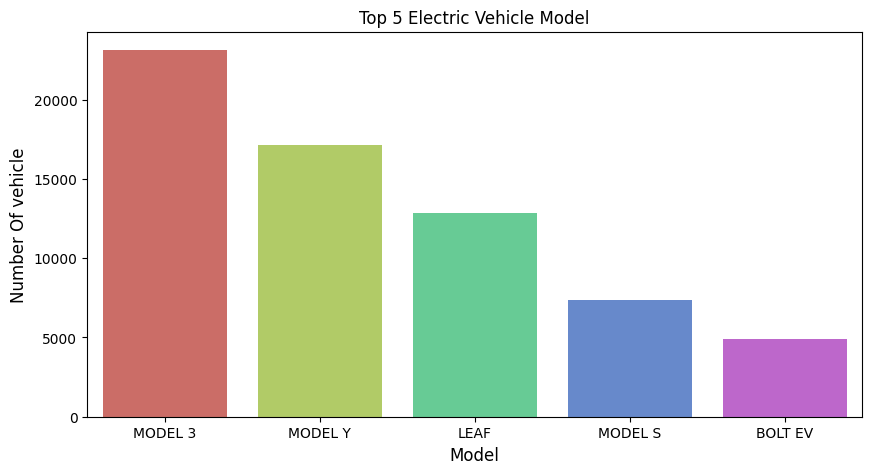

In [77]:
# Top 5 Electric Vehicles model

plt.figure(figsize=(10,5))
model =sns.barplot(x=df['Model'].value_counts().index[:5], y=df["Model"].value_counts()[:5], data=df, palette='hls')

plt.xlabel('Model', fontsize=12)
plt.ylabel('Number Of vehicle', fontsize=12)

plt.title('Top 5 Electric Vehicle Model', fontsize=12)
plt.show()

In [78]:
px.histogram(df, x = 'Model', title = "Frequency Distribution of models in electric vehicle")

In [79]:
px.histogram(df, x = 'Model Year', title = 'Frequency distribution of data year wise')

In [80]:
px.scatter(df, x='Make', y='Electric Range')

###  Task2 - Create a Choropleth to display the number of EV vehicles based on location.

In [82]:
df_count = df.groupby('State').size().reset_index(name='count')

In [90]:
df_count.head()

,State,count
0,AK,1
1,AL,1
2,AR,4
3,AZ,6
4,CA,76


fig = px.choropleth(df_count,
    locations='State', 
    color='count',
    hover_name='State',
    locationmode='USA-states'
)

fig.show()

### Task3 - Create a Racing Bar Plot to display the animation of EV Make and its count each year.

In [86]:
#!pip install bar-chart-race

In [87]:
df.columns

Index(['VIN (1-10)', 'County', 'City', 'State', 'Postal Code', 'Model Year',
       'Make', 'Model', 'Electric Vehicle Type',
       'Clean Alternative Fuel Vehicle (CAFV) Eligibility', 'Electric Range',
       'Base MSRP', 'Legislative District', 'DOL Vehicle ID',
       'Vehicle Location', 'Electric Utility', '2020 Census Tract'],
      dtype='object')

In [88]:

df1 = pd.crosstab(index = df["Model Year"], columns = df["Make"])
df1.head(10)

Make,AUDI,AZURE DYNAMICS,BENTLEY,BMW,CADILLAC,CHEVROLET,CHRYSLER,FIAT,FISKER,FORD,...,POLESTAR,PORSCHE,RIVIAN,SMART,SUBARU,TESLA,TH!NK,TOYOTA,VOLKSWAGEN,VOLVO
Model Year,,,,,,,,,,,,,,,,,,,,,
1997,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1998,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
1999,0,0,0,0,0,0,0,0,0,3,...,0,0,0,0,0,0,0,0,0,0
2000,0,0,0,0,0,0,0,0,0,10,...,0,0,0,0,0,0,0,0,0,0
2002,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,2,0,0
2008,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,23,0,0,0,0
2010,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,24,0,0,0,0
2011,0,4,0,0,0,71,0,0,0,0,...,0,0,0,0,0,7,3,0,0,0
2012,0,3,0,0,0,496,0,0,20,15,...,0,0,0,0,0,134,0,385,0,0


In [89]:
bcr.bar_chart_race(
    df = df1,

    # sort the bar for each period
    sort="desc",


    # number of bars to display in each frame
    n_bars=10,


    # smoothness of the animation
    steps_per_period=45,
    period_length=3000,

    # custom set of colors
    cmap=[ '#6ECBCE', '#FF2243', '#FFC33D', '#CE9673', '#FFA0FF', '#6501E5', '#F79522', '#699AF8', '#34718E', '#00DBCD',
           '#00A3FF', '#F8A737', '#56BD5B', '#D40CE5', '#6936F9', '#FF317B', '#0000F3', '#FFA0A0', '#31FF83', '#0556F3'],
    
    # title and its styles
    title='Racing Bar Chart of EV Make and its count each year',
    
    # adjust the position and style of the period label
    period_label={'x': .98, 'y': .10,
                  'ha': 'right',
                  'va': 'center',
                  'size': 10,
                  'weight': 'semibold'
                  }
)

C:\Users\HP PC\Desktop\dl1\lib\site-packages\bar_chart_race\_make_chart.py:286: UserWarning:

FixedFormatter should only be used together with FixedLocator

C:\Users\HP PC\Desktop\dl1\lib\site-packages\bar_chart_race\_make_chart.py:287: UserWarning:

FixedFormatter should only be used together with FixedLocator

C:\Users\HP PC\Desktop\dl1\lib\site-packages\bar_chart_race\_make_chart.py:226: UserWarning:

Some of your columns never make an appearance in the animation. To reduce color repetition, set `filter_column_colors` to `True`



### Conclusion 

- Applied Exploratory Data Analysis(Univariate and Bivariate) using plotly.express library and got insights from the data.
- Created a Choropleth to display the number of EV vehicles based on location
- Created a Racing Bar Plot to display the animation of EV Make and its count each year.